# Cài đặt và import các thư viện cần thiết

In [1]:
# Install the required libraries
#SAM
!pip install git+https://github.com/facebookresearch/segment-anything.git
#Transformers
!pip install -q git+https://github.com/huggingface/transformers.git
#Datasets to prepare data and monai if you want to use special loss functions
!pip install datasets
!pip install -q monai
#Patchify to divide large images into smaller patches for training. (Not necessary for smaller images)
!pip install patchify

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-cowy41mg
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-cowy41mg
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import os
from patchify import patchify  #Only to handle large images
import random
from scipy import ndimage
import cv2
from datasets import Dataset
from PIL import Image
import matplotlib.pyplot as plt
import random
import torch

# Chia dataset để training model

## Chia dataset cho tập train

In [3]:
# Đường dẫn tới thư mục chứa các hình ảnh
image_folder = "/kaggle/input/otu-2d/OTU_2D/train/Image"

# Lấy danh sách các tệp trong thư mục và sắp xếp theo thứ tự tên tăng dần từ A đến Z
image_files = sorted(os.listdir(image_folder))

# Khởi tạo một danh sách để chứa các hình ảnh dưới dạng mảng NumPy
image_array_list = []

# Lặp qua tất cả các tệp trong thư mục đã sắp xếp
for filename in image_files:
    # Kiểm tra xem tệp có phải là hình ảnh không
    if filename.endswith(('.JPG')):
        # Đường dẫn đầy đủ tới hình ảnh
        img_path = os.path.join(image_folder, filename)

        # Đọc hình ảnh
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img = cv2.resize(img, (256, 256))

        # Kiểm tra xem hình ảnh có được đọc thành công hay không
        if img is not None:
            # Thêm hình ảnh vào danh sách
            image_array_list.append(img)
        else:
            print(f"Không thể đọc hình ảnh {filename}")

# Chuyển đổi danh sách hình ảnh thành mảng NumPy
train_images_np = np.array(image_array_list)

# In ra kích thước của mảng hình ảnh
print("Kích thước của mảng hình ảnh:", train_images_np.shape)


Kích thước của mảng hình ảnh: (1177, 256, 256, 3)


In [4]:
# Đường dẫn tới thư mục chứa các hình ảnh
image_folder = "/kaggle/input/otu-2d/OTU_2D/train/Label"

# Lấy danh sách các tệp trong thư mục và sắp xếp theo thứ tự tên tăng dần từ A đến Z
image_files = sorted(os.listdir(image_folder))

# Khởi tạo một danh sách để chứa các hình ảnh dưới dạng mảng NumPy
image_array_list = []

# Lặp qua tất cả các tệp trong thư mục đã được sắp xếp
for filename in image_files:
    # Kiểm tra xem tệp có phải là hình ảnh không
    if filename.endswith('.PNG'):
        # Đường dẫn đầy đủ tới hình ảnh
        img_path = os.path.join(image_folder, filename)

        # Đọc hình ảnh
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        img = cv2.resize(img, (256, 256))
        img = img / 255.0
        (thresh, img) = cv2.threshold(img, 0, 1, cv2.THRESH_BINARY)

        # img = np.int32(img)

        # Kiểm tra xem hình ảnh có được đọc thành công hay không
        if img is not None:
            # Thêm hình ảnh vào danh sách
            image_array_list.append(img)
        else:
            print(f"Không thể đọc hình ảnh {filename}")

# Chuyển đổi danh sách hình ảnh thành mảng NumPy
train_labels_np = np.array(image_array_list)

# In ra kích thước của mảng hình ảnh
print("Kích thước của mảng mặt nạ:", train_labels_np.shape)

Kích thước của mảng mặt nạ: (1177, 256, 256)


In [5]:
# Convert the NumPy arrays to Pillow images and store them in a dictionary
dataset_dict = {
    "image": [Image.fromarray(img).convert('RGB') for img in train_images_np],
    "label": [Image.fromarray(mask).convert('I') for mask in train_labels_np],
}

# Create the dataset using the datasets.Dataset class
train_dataset = Dataset.from_dict(dataset_dict)

In [6]:
train_dataset

Dataset({
    features: ['image', 'label'],
    num_rows: 1177
})

## Chia dataset cho tập validation

In [7]:
# Đường dẫn tới thư mục chứa các hình ảnh
image_folder = "/kaggle/input/otu-2d/OTU_2D/validation/Image"

# Lấy danh sách các tệp trong thư mục và sắp xếp theo thứ tự tên tăng dần từ A đến Z
image_files = sorted(os.listdir(image_folder))

# Khởi tạo một danh sách để chứa các hình ảnh dưới dạng mảng NumPy
image_array_list = []

# Lặp qua tất cả các tệp trong thư mục đã sắp xếp
for filename in image_files:
    # Kiểm tra xem tệp có phải là hình ảnh không
    if filename.endswith(('.JPG')):
        # Đường dẫn đầy đủ tới hình ảnh
        img_path = os.path.join(image_folder, filename)

        # Đọc hình ảnh
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img = cv2.resize(img, (256, 256))

        # Kiểm tra xem hình ảnh có được đọc thành công hay không
        if img is not None:
            # Thêm hình ảnh vào danh sách
            image_array_list.append(img)
        else:
            print(f"Không thể đọc hình ảnh {filename}")

# Chuyển đổi danh sách hình ảnh thành mảng NumPy
val_images_np = np.array(image_array_list)

# In ra kích thước của mảng hình ảnh
print("Kích thước của mảng hình ảnh:", val_images_np.shape)


Kích thước của mảng hình ảnh: (146, 256, 256, 3)


In [8]:
# Đường dẫn tới thư mục chứa các hình ảnh
image_folder = "/kaggle/input/otu-2d/OTU_2D/validation/Label"

# Lấy danh sách các tệp trong thư mục và sắp xếp theo thứ tự tên tăng dần từ A đến Z
image_files = sorted(os.listdir(image_folder))

# Khởi tạo một danh sách để chứa các hình ảnh dưới dạng mảng NumPy
image_array_list = []

# Lặp qua tất cả các tệp trong thư mục đã được sắp xếp
for filename in image_files:
    # Kiểm tra xem tệp có phải là hình ảnh không
    if filename.endswith('.PNG'):
        # Đường dẫn đầy đủ tới hình ảnh
        img_path = os.path.join(image_folder, filename)

        # Đọc hình ảnh
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        img = cv2.resize(img, (256, 256))
        img = img / 255.0
        (thresh, img) = cv2.threshold(img, 0, 1, cv2.THRESH_BINARY)

        # img = np.int32(img)

        # Kiểm tra xem hình ảnh có được đọc thành công hay không
        if img is not None:
            # Thêm hình ảnh vào danh sách
            image_array_list.append(img)
        else:
            print(f"Không thể đọc hình ảnh {filename}")

# Chuyển đổi danh sách hình ảnh thành mảng NumPy
val_labels_np = np.array(image_array_list)

# In ra kích thước của mảng hình ảnh
print("Kích thước của mảng mặt nạ:", val_labels_np.shape)

Kích thước của mảng mặt nạ: (146, 256, 256)


In [9]:
# Convert the NumPy arrays to Pillow images and store them in a dictionary
dataset_dict = {
    "image": [Image.fromarray(img).convert('RGB') for img in val_images_np],
    "label": [Image.fromarray(mask).convert('I') for mask in val_labels_np],
}

# Create the dataset using the datasets.Dataset class
val_dataset = Dataset.from_dict(dataset_dict)

In [10]:
val_dataset

Dataset({
    features: ['image', 'label'],
    num_rows: 146
})

## Chia dataset cho tập test

In [11]:
# Đường dẫn tới thư mục chứa các hình ảnh
image_folder = "/kaggle/input/otu-2d/OTU_2D/test/Image"

# Lấy danh sách các tệp trong thư mục và sắp xếp theo thứ tự tên tăng dần từ A đến Z
image_files = sorted(os.listdir(image_folder))

# Khởi tạo một danh sách để chứa các hình ảnh dưới dạng mảng NumPy
image_array_list = []

# Lặp qua tất cả các tệp trong thư mục đã sắp xếp
for filename in image_files:
    # Kiểm tra xem tệp có phải là hình ảnh không
    if filename.endswith(('.JPG')):
        # Đường dẫn đầy đủ tới hình ảnh
        img_path = os.path.join(image_folder, filename)

        # Đọc hình ảnh
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img = cv2.resize(img, (256, 256))

        # Kiểm tra xem hình ảnh có được đọc thành công hay không
        if img is not None:
            # Thêm hình ảnh vào danh sách
            image_array_list.append(img)
        else:
            print(f"Không thể đọc hình ảnh {filename}")

# Chuyển đổi danh sách hình ảnh thành mảng NumPy
test_images_np = np.array(image_array_list)

# In ra kích thước của mảng hình ảnh
print("Kích thước của mảng hình ảnh:", test_images_np.shape)


Kích thước của mảng hình ảnh: (146, 256, 256, 3)


In [12]:
# Đường dẫn tới thư mục chứa các hình ảnh
image_folder = "/kaggle/input/otu-2d/OTU_2D/test/Label"

# Lấy danh sách các tệp trong thư mục và sắp xếp theo thứ tự tên tăng dần từ A đến Z
image_files = sorted(os.listdir(image_folder))

# Khởi tạo một danh sách để chứa các hình ảnh dưới dạng mảng NumPy
image_array_list = []

# Lặp qua tất cả các tệp trong thư mục đã được sắp xếp
for filename in image_files:
    # Kiểm tra xem tệp có phải là hình ảnh không
    if filename.endswith('.PNG'):
        # Đường dẫn đầy đủ tới hình ảnh
        img_path = os.path.join(image_folder, filename)

        # Đọc hình ảnh
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        img = cv2.resize(img, (256, 256))
        img = img / 255.0
        (thresh, img) = cv2.threshold(img, 0, 1, cv2.THRESH_BINARY)

        # img = np.int32(img)

        # Kiểm tra xem hình ảnh có được đọc thành công hay không
        if img is not None:
            # Thêm hình ảnh vào danh sách
            image_array_list.append(img)
        else:
            print(f"Không thể đọc hình ảnh {filename}")

# Chuyển đổi danh sách hình ảnh thành mảng NumPy
test_labels_np = np.array(image_array_list)

# In ra kích thước của mảng hình ảnh
print("Kích thước của mảng mặt nạ:", test_labels_np.shape)

Kích thước của mảng mặt nạ: (146, 256, 256)


In [13]:
# Convert the NumPy arrays to Pillow images and store them in a dictionary
dataset_dict = {
    "image": [Image.fromarray(img).convert('RGB') for img in test_images_np],
    "label": [Image.fromarray(mask).convert('I') for mask in test_labels_np],
}

# Create the dataset using the datasets.Dataset class
test_dataset = Dataset.from_dict(dataset_dict)

In [14]:
test_dataset

Dataset({
    features: ['image', 'label'],
    num_rows: 146
})

# Kiểm tra ảnh và mặt nạ

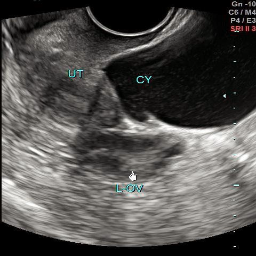

In [15]:
img_num = random.randint(0, train_images_np.shape[0]-1)
example = train_dataset[img_num]
image = example["image"]
image

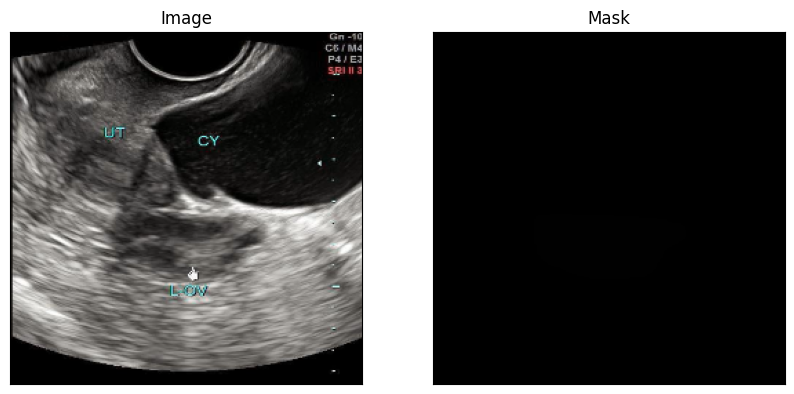

In [16]:
example_image = train_dataset[img_num]["image"]
example_mask = train_dataset[img_num]["label"]

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Plot the first image on the left
axes[0].imshow(np.array(example_image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(example_mask, cmap='gray')  # Assuming the second image is grayscale
axes[1].set_title("Mask")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

(-0.5, 255.5, 255.5, -0.5)

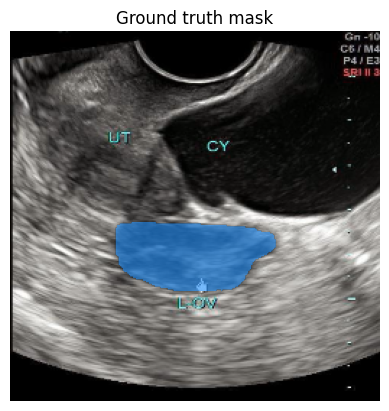

In [17]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.2])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

fig, axes = plt.subplots()

axes.imshow(np.array(image))
ground_truth_seg = np.array(example["label"])
show_mask(ground_truth_seg, axes)
axes.title.set_text(f"Ground truth mask")
axes.axis("off")

# Vẽ bounding boxes cho mặt nạ

In [18]:
#Get bounding boxes from mask.
def get_bounding_box(ground_truth_map):
  # get bounding box from mask
  y_indices, x_indices = np.where(ground_truth_map > 0)
  x_min, x_max = np.min(x_indices), np.max(x_indices)
  y_min, y_max = np.min(y_indices), np.max(y_indices)
  # add perturbation to bounding box coordinates
  H, W = ground_truth_map.shape
  x_min = max(0, x_min - np.random.randint(0, 20))
  x_max = min(W, x_max + np.random.randint(0, 20))
  y_min = max(0, y_min - np.random.randint(0, 20))
  y_max = min(H, y_max + np.random.randint(0, 20))
  bbox = [x_min, y_min, x_max, y_max]

  return bbox

# Training Model

## Hàm tạo 1 dataset input images and mask

In [19]:
from torch.utils.data import Dataset

class SAMDataset(Dataset):
  """
  This class is used to create a dataset that serves input images and masks.
  It takes a dataset and a processor as input and overrides the __len__ and __getitem__ methods of the Dataset class.
  """
  def __init__(self, dataset, processor):
    self.dataset = dataset
    self.processor = processor

  def __len__(self):
    return len(self.dataset)

  def __getitem__(self, idx):
    item = self.dataset[idx]
    image = item["image"]
    ground_truth_mask = np.array(item["label"])

    # get bounding box prompt | vẽ box cho mặt nạ
    prompt = get_bounding_box(ground_truth_mask)

    # prepare image and prompt for the model | Chuẩn bị mặt nạ và hộp giới hạn
    inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")

    # remove batch dimension which the processor adds by default | Loại bỏ chiều Batch được thêm vào mặc định
    inputs = {k:v.squeeze(0) for k,v in inputs.items()}

    # add ground truth segmentation | Thêm ground truth để đánh giá việc Segment sau này, đánh giá hiệu suất mô hình
    inputs["ground_truth_mask"] = ground_truth_mask

    return inputs

## Load model SAM

### Xử lý dữ liệu để tương thích với đầu vào Model

In [20]:
# Initialize the processor
from transformers import SamProcessor
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

2024-03-27 13:01:46.609806: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-27 13:01:46.609908: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-27 13:01:46.761286: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

In [21]:
# Create an instance of the SAMDataseta
train_dataset = SAMDataset(dataset=train_dataset, processor=processor)
val_dataset = SAMDataset(dataset=val_dataset, processor=processor)
# test_dataset = SAMDataset(dataset=test_dataset, processor=processor)

In [22]:
example = train_dataset[0]
for k,v in example.items():
  print(f'{k}: {v.shape}')

pixel_values: torch.Size([3, 1024, 1024])
original_sizes: torch.Size([2])
reshaped_input_sizes: torch.Size([2])
input_boxes: torch.Size([1, 4])
ground_truth_mask: (256, 256)


In [23]:
example = val_dataset[0]
for k,v in example.items():
  print(f'{k}: {v.shape}')

pixel_values: torch.Size([3, 1024, 1024])
original_sizes: torch.Size([2])
reshaped_input_sizes: torch.Size([2])
input_boxes: torch.Size([1, 4])
ground_truth_mask: (256, 256)


In [24]:
# example = test_dataset[0]
# for k,v in example.items():
#   print(f'{k}: {v.shape}')

In [25]:
# Create a DataLoader instance for the training dataset
from torch.utils.data import DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True, drop_last=False)
val_dataloader = DataLoader(val_dataset, batch_size=2, shuffle=True, drop_last=False)
# test_dataloader = DataLoader(test_dataset, batch_size=2, shuffle=True, drop_last=False)

In [26]:
batch = next(iter(train_dataloader))
for k,v in batch.items():
  print(k,v.shape)

pixel_values torch.Size([2, 3, 1024, 1024])
original_sizes torch.Size([2, 2])
reshaped_input_sizes torch.Size([2, 2])
input_boxes torch.Size([2, 1, 4])
ground_truth_mask torch.Size([2, 256, 256])


In [27]:
batch = next(iter(val_dataloader))
for k,v in batch.items():
  print(k,v.shape)

pixel_values torch.Size([2, 3, 1024, 1024])
original_sizes torch.Size([2, 2])
reshaped_input_sizes torch.Size([2, 2])
input_boxes torch.Size([2, 1, 4])
ground_truth_mask torch.Size([2, 256, 256])


In [28]:
# batch = next(iter(test_dataloader))
# for k,v in batch.items():
#   print(k,v.shape)

In [29]:
batch["ground_truth_mask"].shape

torch.Size([2, 256, 256])

### Load model Pretrained của Segment Anything

In [30]:
# Load the model
from transformers import SamModel
model = SamModel.from_pretrained("facebook/sam-vit-base")

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/375M [00:00<?, ?B/s]

### Khởi tạo model với hàm tối ưu là Adam, hàm loss là DiceCELoss

In [31]:
import torch.optim as optim
from monai.losses import DiceLoss, DiceCELoss, DiceFocalLoss

# Khởi tạo optimizer
optimizer = optim.Adam(model.parameters(), lr=1e-5, weight_decay=0)

# Sử dụng DiceCELoss
seg_loss = DiceCELoss(sigmoid=True, squared_pred=True, reduction='mean')

# Sử dụng DiceFocalLoss
# seg_loss = DiceFocalLoss(sigmoid=True, gamma=0.25)

# Sử dụng DiceLoss
# seg_loss = DiceLoss(to_onehot_y=True, softmax=True)



### Train Model

In [32]:
model.load_state_dict(torch.load("/kaggle/input/50-epochs/checkpoint_SAM/best_model_weights.pt"))

<All keys matched successfully>

### Early Stopping

In [33]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize
import os

# Tạo thư mục checkpoint
checkpoint_dir = '/kaggle/working/checkpoint_SAM'
os.makedirs(checkpoint_dir, exist_ok=True)

# Biến để theo dõi loss tốt nhất và trọng số của nó
best_loss = float('inf')
best_weights = None

# Thêm mảng ghi lại loss
loss_list = []
# Early stopping parameters
patience = 3  # Số lượng epochs mà mô hình không cải thiện trước khi dừng sớm
counter = 0

# Training loop
num_epochs = 50

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

model.train()
for epoch in range(num_epochs):
    epoch_losses = []
    correct_predictions = 0
    total_predictions = 0

    for batch in tqdm(train_dataloader):
        # forward pass
        outputs = model(pixel_values=batch["pixel_values"].to(device),
                        input_boxes=batch["input_boxes"].to(device),
                        multimask_output=False)

        # compute loss
        predicted_masks = outputs.pred_masks.squeeze(1)
        ground_truth_masks = batch["ground_truth_mask"].float().to(device)
        loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))

        # backward pass (compute gradients of parameters w.r.t. loss)
        optimizer.zero_grad()
        loss.backward()

        # optimize
        optimizer.step()
        epoch_losses.append(loss.item())

    # Lưu trọng số của mô hình sau mỗi epoch vào thư mục checkpoint
    torch.save(model.state_dict(), os.path.join(checkpoint_dir, f'model_epoch_{epoch}.pt'))

    # Tính loss trung bình và accuracy của epoch hiện tại
    epoch_loss_mean = mean(epoch_losses)
    loss_list.append(epoch_loss_mean)

    # In thông tin về epoch, loss và accuracy
    print(f'EPOCH: {epoch}')
    print(f'Mean loss: {epoch_loss_mean}')

    # Kiểm tra xem loss của epoch hiện tại có là tốt nhất không
    if epoch_loss_mean < best_loss:
        # Nếu là loss tốt nhất, cập nhật biến best_loss và lưu trọng số tốt nhất
        best_loss = epoch_loss_mean
        best_weights = model.state_dict()
        torch.save(best_weights, os.path.join(checkpoint_dir, 'best_model_weights.pt'))
        print("Best model weights saved.")

    # Kiểm tra early stopping
    if epoch > 0:  # Bắt đầu kiểm tra early stopping sau epoch đầu tiên
        if epoch_loss_mean >= prev_epoch_loss:
            counter += 1
            if counter >= patience:
                print(f"Early stopping! No improvement in {patience} epochs.")
                break
        else:
            counter = 0  # Reset counter
    prev_epoch_loss = epoch_loss_mean  # Lưu loss của epoch hiện tại để so sánh với epoch tiếp theo


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 0
Mean loss: 0.0812521314751262
Best model weights saved.


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 1
Mean loss: 0.08068557466571623
Best model weights saved.


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 2
Mean loss: 0.08071293502552704


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 3
Mean loss: 0.08093866116425785


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 4
Mean loss: 0.07973695708302772
Best model weights saved.


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 5
Mean loss: 0.07880911063750753
Best model weights saved.


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 6
Mean loss: 0.07770291581458977
Best model weights saved.


100%|██████████| 589/589 [06:02<00:00,  1.62it/s]


EPOCH: 7
Mean loss: 0.07730361545720914
Best model weights saved.


100%|██████████| 589/589 [06:03<00:00,  1.62it/s]


EPOCH: 8
Mean loss: 0.07821845558609541


100%|██████████| 589/589 [06:03<00:00,  1.62it/s]


EPOCH: 9
Mean loss: 0.076906396205741
Best model weights saved.


100%|██████████| 589/589 [06:02<00:00,  1.63it/s]


EPOCH: 10
Mean loss: 0.07665839230290698
Best model weights saved.


100%|██████████| 589/589 [06:02<00:00,  1.63it/s]


EPOCH: 11
Mean loss: 0.07506592107813406
Best model weights saved.


100%|██████████| 589/589 [06:02<00:00,  1.63it/s]


EPOCH: 12
Mean loss: 0.07550473043502187


100%|██████████| 589/589 [06:02<00:00,  1.63it/s]


EPOCH: 13
Mean loss: 0.07535525049906737


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 14
Mean loss: 0.07619809559174831


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 15
Mean loss: 0.07290518702543855
Best model weights saved.


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 16
Mean loss: 0.0736680760132133


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 17
Mean loss: 0.07343586208219743


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 18
Mean loss: 0.07313896315599237


100%|██████████| 589/589 [06:02<00:00,  1.63it/s]


EPOCH: 19
Mean loss: 0.07324108957662445


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 20
Mean loss: 0.07259841605464347
Best model weights saved.


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 21
Mean loss: 0.07177910425009267
Best model weights saved.


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 22
Mean loss: 0.0725533817602236


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 23
Mean loss: 0.07190242780970191


100%|██████████| 589/589 [06:02<00:00,  1.63it/s]


EPOCH: 24
Mean loss: 0.07018805382510802
Best model weights saved.


100%|██████████| 589/589 [06:02<00:00,  1.62it/s]


EPOCH: 25
Mean loss: 0.07045579465431856


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 26
Mean loss: 0.07075227670852215


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 27
Mean loss: 0.06984046134142702
Best model weights saved.


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 28
Mean loss: 0.07049438989830341


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 29
Mean loss: 0.0678514165958747
Best model weights saved.


100%|██████████| 589/589 [06:00<00:00,  1.63it/s]


EPOCH: 30
Mean loss: 0.06732991842809173
Best model weights saved.


100%|██████████| 589/589 [06:02<00:00,  1.62it/s]


EPOCH: 31
Mean loss: 0.06822325592205966


100%|██████████| 589/589 [06:02<00:00,  1.62it/s]


EPOCH: 32
Mean loss: 0.06798820629880363


100%|██████████| 589/589 [06:02<00:00,  1.62it/s]


EPOCH: 33
Mean loss: 0.06770988376668839


100%|██████████| 589/589 [06:03<00:00,  1.62it/s]


EPOCH: 34
Mean loss: 0.06673147740294755
Best model weights saved.


100%|██████████| 589/589 [06:03<00:00,  1.62it/s]


EPOCH: 35
Mean loss: 0.06744684826057715


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 36
Mean loss: 0.06699419215776925


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 37
Mean loss: 0.06636138568697134
Best model weights saved.


100%|██████████| 589/589 [06:04<00:00,  1.61it/s]


EPOCH: 38
Mean loss: 0.06698753660408771


100%|██████████| 589/589 [06:04<00:00,  1.61it/s]


EPOCH: 39
Mean loss: 0.06605319709774796
Best model weights saved.


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 40
Mean loss: 0.066217146301563


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 41
Mean loss: 0.06495286856978777
Best model weights saved.


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 42
Mean loss: 0.06553938065565401


100%|██████████| 589/589 [06:06<00:00,  1.61it/s]


EPOCH: 43
Mean loss: 0.06373818485929626
Best model weights saved.


100%|██████████| 589/589 [06:05<00:00,  1.61it/s]


EPOCH: 44
Mean loss: 0.06480671155483088


100%|██████████| 589/589 [06:04<00:00,  1.62it/s]


EPOCH: 45
Mean loss: 0.06426212625777276


100%|██████████| 589/589 [06:03<00:00,  1.62it/s]


EPOCH: 46
Mean loss: 0.06349659258901365
Best model weights saved.


100%|██████████| 589/589 [06:02<00:00,  1.62it/s]


EPOCH: 47
Mean loss: 0.0645888579696265


100%|██████████| 589/589 [06:02<00:00,  1.62it/s]


EPOCH: 48
Mean loss: 0.06283728113312571
Best model weights saved.


100%|██████████| 589/589 [06:01<00:00,  1.63it/s]


EPOCH: 49
Mean loss: 0.061797578592985514
Best model weights saved.


In [34]:
loss_list

[0.0812521314751262,
 0.08068557466571623,
 0.08071293502552704,
 0.08093866116425785,
 0.07973695708302772,
 0.07880911063750753,
 0.07770291581458977,
 0.07730361545720914,
 0.07821845558609541,
 0.076906396205741,
 0.07665839230290698,
 0.07506592107813406,
 0.07550473043502187,
 0.07535525049906737,
 0.07619809559174831,
 0.07290518702543855,
 0.0736680760132133,
 0.07343586208219743,
 0.07313896315599237,
 0.07324108957662445,
 0.07259841605464347,
 0.07177910425009267,
 0.0725533817602236,
 0.07190242780970191,
 0.07018805382510802,
 0.07045579465431856,
 0.07075227670852215,
 0.06984046134142702,
 0.07049438989830341,
 0.0678514165958747,
 0.06732991842809173,
 0.06822325592205966,
 0.06798820629880363,
 0.06770988376668839,
 0.06673147740294755,
 0.06744684826057715,
 0.06699419215776925,
 0.06636138568697134,
 0.06698753660408771,
 0.06605319709774796,
 0.066217146301563,
 0.06495286856978777,
 0.06553938065565401,
 0.06373818485929626,
 0.06480671155483088,
 0.064262126257772

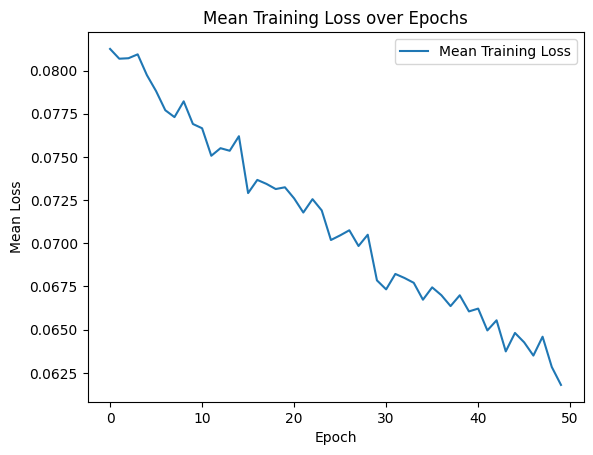

In [35]:
import matplotlib.pyplot as plt
import numpy as np

loss = np.arange(num_epochs)

# Biểu đồ mean loss
plt.plot(loss, loss_list, label='Mean Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Mean Loss')
plt.title('Mean Training Loss over Epochs')
plt.legend()
plt.show()


### Load hàm loss đánh giá model

In [36]:
from tqdm import tqdm
from statistics import mean
import torch
from torch.nn.functional import threshold, normalize

smooth=1e-10

# Define functions for calculating evaluation metrics
def dice(predicted, target):
    true_positive = torch.sum(predicted * target)
    false_negative = torch.sum(target) - true_positive
    false_positive = torch.sum(predicted) - true_positive
    return (2. * true_positive + smooth) / (2. *true_positive + false_negative + false_positive + smooth)

def iou(predicted, target):
    intersection = torch.sum(predicted * target)
    union = torch.sum(predicted) + torch.sum(target) - intersection
    return (intersection + smooth) / (union + smooth)

def recall(predicted, target):
    true_positive = torch.sum(predicted * target)
    false_negative = torch.sum(target) - true_positive
    return (true_positive + smooth) / (true_positive + false_negative + smooth)

def precision(predicted, target):
    true_positive = torch.sum(predicted * target)
    false_positive = torch.sum(predicted) - true_positive
    return (true_positive + smooth) / (true_positive + false_positive + smooth)

### Đánh giá trọng số mô hình với tập Validation Dataset (IOU, Precision, Recall, Dice)

In [37]:
# Tải trọng số từ checkpoint
checkpoint_path = "/kaggle/working/checkpoint_SAM/best_model_weights.pt"
checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

# Load trọng số vào mô hình
model.load_state_dict(checkpoint)


# Đặt mô hình vào chế độ đánh giá
model.eval()

# Tiếp tục quá trình kiểm tra mô hình như đã thực hiện trước đó
val_dice_scores = []
val_iou_scores = []
val_recall_scores = []
val_precision_scores = []

with torch.no_grad():
    for batch in tqdm(val_dataloader):
        # Forward pass
        outputs = model(pixel_values=batch["pixel_values"].to(device),
                        input_boxes=batch["input_boxes"].to(device),
                        multimask_output=False)

        # Compute evaluation metrics
        predicted_masks = (outputs.pred_masks.squeeze() > 0.5).float() 
        ground_truth_masks = batch["ground_truth_mask"].float().to(device)

        val_dice_scores.append(dice(predicted_masks, ground_truth_masks))
        val_iou_scores.append(iou(predicted_masks, ground_truth_masks))
        val_recall_scores.append(recall(predicted_masks, ground_truth_masks))
        val_precision_scores.append(precision(predicted_masks, ground_truth_masks))

# Print evaluation metrics
print("\n")
print(f'Validation Dice: {torch.tensor(val_dice_scores).mean().item():.4f}')
print(f'Validation IOU: {torch.tensor(val_iou_scores).mean().item():.4f}')
print(f'Validation Recall: {torch.tensor(val_recall_scores).mean().item():.4f}')
print(f'Validation Precision: {torch.tensor(val_precision_scores).mean().item():.4f}')


100%|██████████| 73/73 [00:43<00:00,  1.69it/s]



Validation Dice: 0.9115
Validation IOU: 0.8397
Validation Recall: 0.8800
Validation Precision: 0.9495


In [38]:
# # Check if GPU is available, otherwise use CPU
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# # Move model to the device
# model.to(device)

# # Tải trọng số từ checkpoint
# checkpoint_path = "/kaggle/working/checkpoint_SAM/best_model_weights.pt"
# checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

# # Load trọng số vào mô hình
# model.load_state_dict(checkpoint)

# # Đặt mô hình vào chế độ đánh giá
# model.eval()

# # Tiếp tục quá trình kiểm tra mô hình như đã thực hiện trước đó
# test_dice_scores = []
# test_iou_scores = []
# test_recall_scores = []
# test_precision_scores = []

# with torch.no_grad():
#     for batch in tqdm(test_dataloader):
#         # Forward pass
#         outputs = model(pixel_values=batch["pixel_values"].to(device),
#                         input_boxes=batch["input_boxes"].to(device),
#                         multimask_output=False)

#         # Compute evaluation metrics
#         predicted_masks = (torch.sigmoid(outputs['pred_masks']).squeeze() > 0.5).float()
#         ground_truth_masks = batch["ground_truth_mask"].float().to(device)

#         test_dice_scores.append(dice(predicted_masks, ground_truth_masks))
#         test_iou_scores.append(iou(predicted_masks, ground_truth_masks))
#         test_recall_scores.append(recall(predicted_masks, ground_truth_masks))
#         test_precision_scores.append(precision(predicted_masks, ground_truth_masks))

# # Print evaluation metrics
# print("\n")
# print(f'Test Dice: {torch.tensor(test_dice_scores).mean().item():.4f}')
# print(f'Test IOU: {torch.tensor(test_iou_scores).mean().item():.4f}')
# print(f'Test Recall: {torch.tensor(test_recall_scores).mean().item():.4f}')
# print(f'Test Precision: {torch.tensor(test_precision_scores).mean().item():.4f}')

### Train tiếp model từ trọng số

## Kiểm thử mô hình

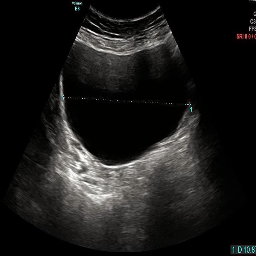

In [39]:
import numpy as np
from PIL import Image

# let's take a random training example
idx = 100

# load image
image = test_dataset[idx]["image"]
image

In [40]:
import torch
# Sử dụng GPU nếu có sẵn
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# get box prompt based on ground truth segmentation map
ground_truth_mask = np.array(test_dataset[idx]["label"])
prompt = get_bounding_box(ground_truth_mask)

# prepare image + box prompt for the model
inputs = processor(image, input_boxes=[[prompt]], return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])


In [41]:
model.eval()

# forward pass
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [42]:
# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)

In [43]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

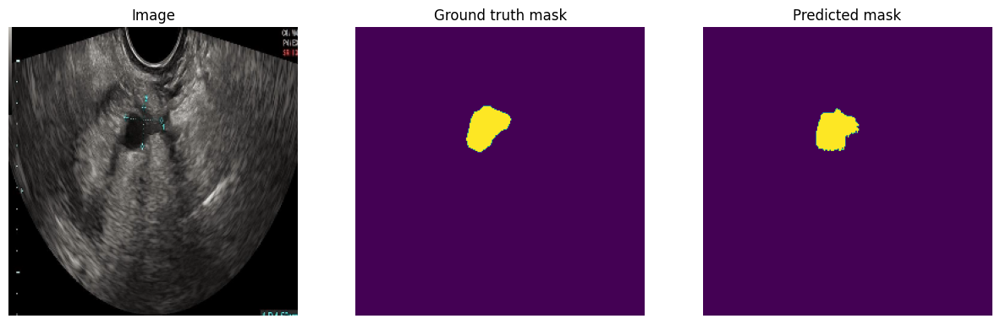

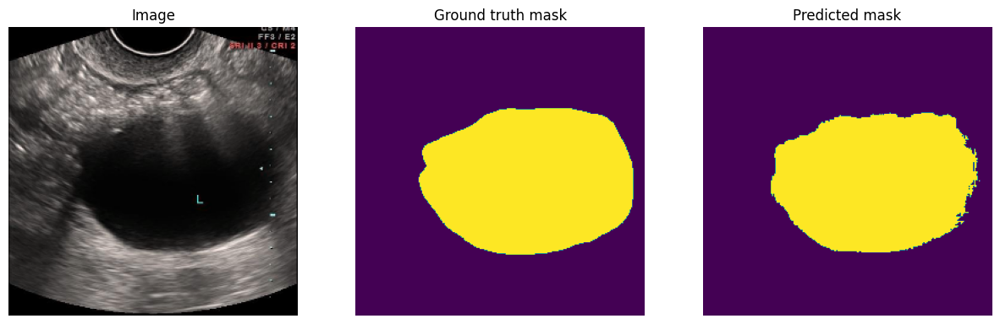

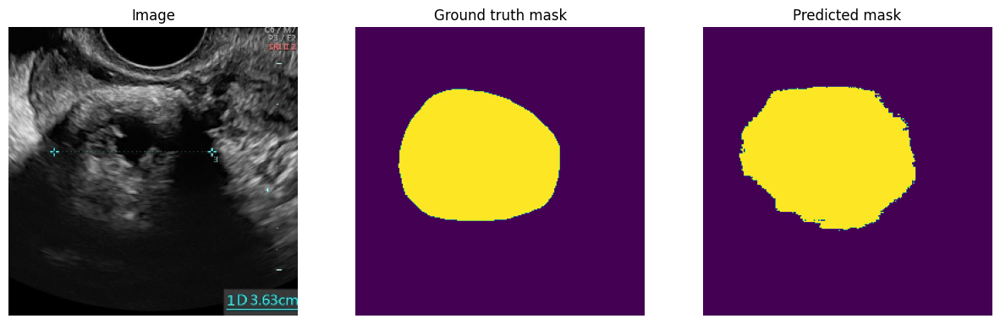

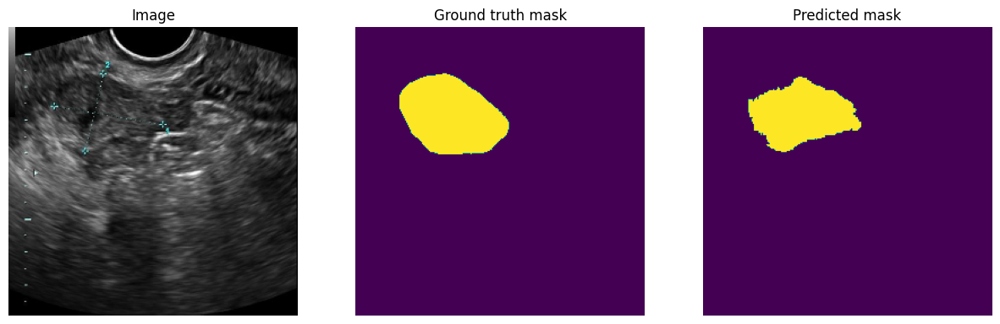

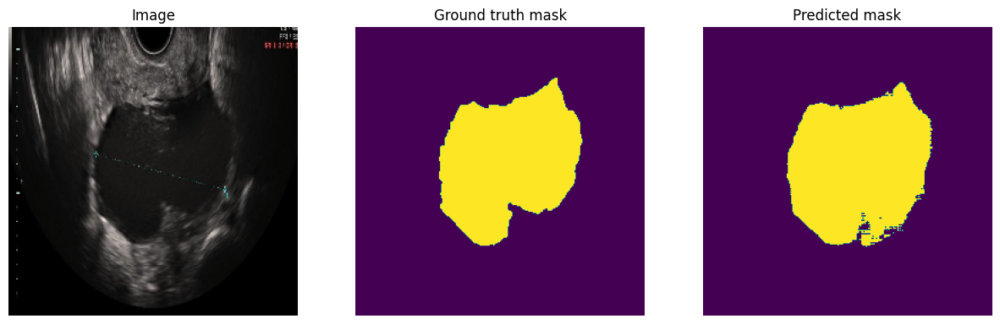

...

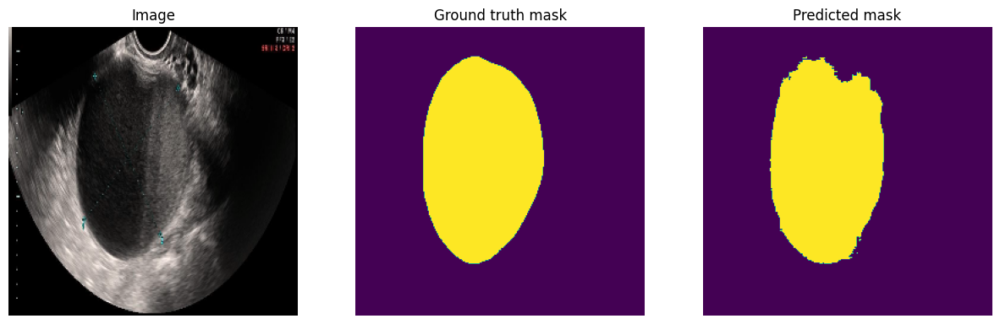

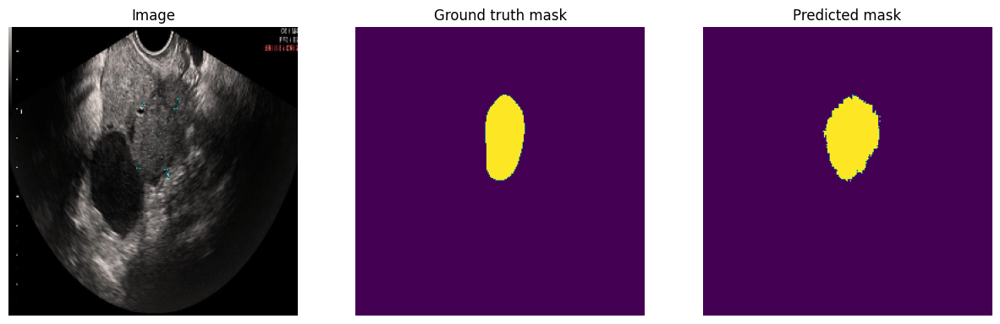

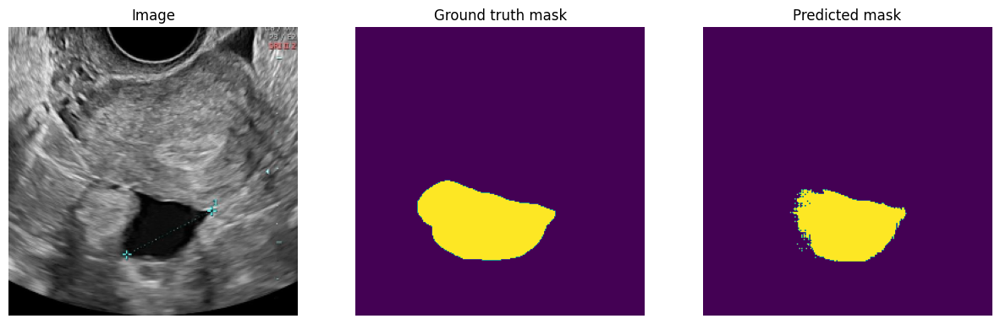

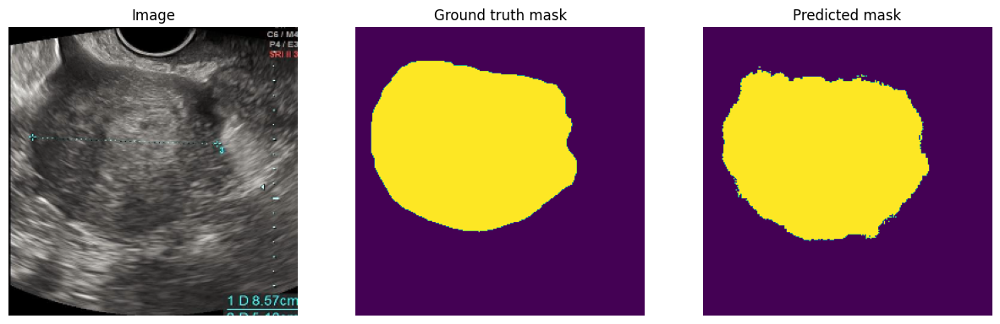

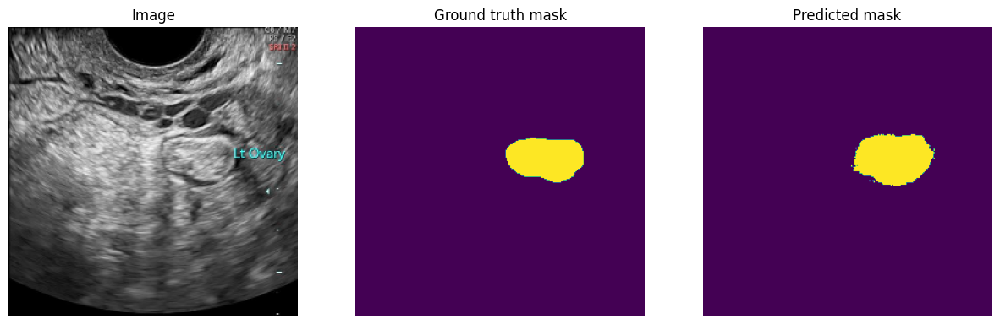

In [44]:
import numpy as np
from PIL import Image
import torch
import matplotlib.pyplot as plt

# Sử dụng GPU nếu có sẵn
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for idx in range(0, len(test_dataset)):  # Duyệt qua các chỉ số từ 1 đến 10
    # load image
    image = test_dataset[idx]["image"]

    # get box prompt based on ground truth segmentation map
    ground_truth_mask = np.array(test_dataset[idx]["label"])
    prompt = get_bounding_box(ground_truth_mask)

    # prepare image + box prompt for the model
    inputs = processor(image, input_boxes=[[prompt]], return_tensors="pt").to(device)

    model.eval()

    # forward pass
    with torch.no_grad():
        outputs = model(**inputs, multimask_output=False)

    # apply sigmoid
    medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
    # convert soft mask to hard mask
    medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
    medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    # Hiển thị hình ảnh
    axes[0].imshow(image)
    axes[0].set_title("Image")
    axes[0].axis("off")

    # Hiển thị đồ thị cho ground truth mask
    axes[1].imshow(ground_truth_mask)
    axes[1].set_title("Ground truth mask")
    axes[1].axis("off")

    # Hiển thị đồ thị cho predicted mask
    axes[2].imshow(medsam_seg)
    axes[2].set_title("Predicted mask")
    axes[2].axis("off")

    plt.show()



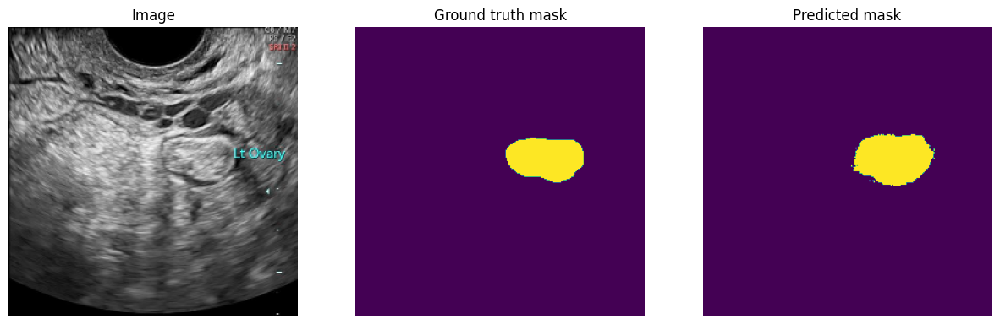

In [45]:
import matplotlib.pyplot as plt

# Tạo subplot với một lưới 1x3
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Hiển thị hình ảnh
axes[0].imshow(image)
axes[0].set_title("Image")
axes[0].axis("off")

# Hiển thị đồ thị cho ground truth mask
axes[1].imshow(ground_truth_mask)
axes[1].set_title("Ground truth mask")
axes[1].axis("off")

# Hiển thị đồ thị cho predicted mask
axes[2].imshow(medsam_seg)
axes[2].set_title("Predicted mask")
axes[2].axis("off")

plt.show()
